# Processus de segmentation de la clientèle

In [ ]:
customer_df = pd.read_csv('customer_df.csv')

In [ ]:
customer_df.shape

(110518, 15)

## Fonctions utilisées

In [ ]:
# Fonctions pour representation graphique

def correlation_graph_interactive(pca, x_y, features,labels=False):
    # Extraire x et y
    x, y = x_y

    # Créer une figure
    fig =  go.Figure()

    # For each component:
    for i in range(0, pca.components_.shape[1]):
        # Créer des annotations de flèches pour les composants
        fig.add_trace(go.Scatter(
            x=[0, pca.components_[x, i]],
            y=[0, pca.components_[y, i]],
            mode='lines+markers+text',
            marker=dict(size=10),
            line=dict(width=2),
            # text=[features[i]]*2,
            # textposition='top center',
            name=f"{features[i]}",
            hovertext=f"{features[i]}: ({pca.components_[x, i]:.2f}, {pca.components_[y, i]:.2f})")
        )
      # Ajouter des annotations pour chaque étiquette afin d'éviter les chevauchements
        if labels:
          fig.add_annotation(
            x=pca.components_[x, i] + (0.1 if pca.components_[x, i] >= 0 else -0.1),
            y=pca.components_[y, i] + (0.1 if pca.components_[y, i] >= 0 else -0.1),
            text=features[i],
            showarrow=False,
            font=dict(size=10),
            bgcolor='rgba(255, 255, 255, 0.7)',
            bordercolor='black'
        )

    # Ajouter des lignes horizontales et verticales
    fig.add_shape(type="line", x0=-1, x1=1, y0=0, y1=0, line=dict(color="grey", dash="dash"))
    fig.add_shape(type="line", x0=0, x1=0, y0=-1, y1=1, line=dict(color="grey", dash="dash"))

    # Ajouter le cercle d'unité pour l'échelle
    theta = np.linspace(0, 2 * np.pi, 100)
    circle_x = np.cos(theta)
    circle_y = np.sin(theta)
    fig.add_trace(go.Scatter(x=circle_x, y=circle_y, mode="lines", name="Unit Circle"))

    # Définir les titres des axes avec le pourcentage de variance expliquée
    fig.update_xaxes(title_text=f'PC{x+1} ({round(100*pca.explained_variance_ratio_[x], 1)}%)')
    fig.update_yaxes(title_text=f'PC{y+1} ({round(100*pca.explained_variance_ratio_[y], 1)}%)')

    # Définir le titre
    fig.update_layout(title_text=f"Cercle des corrélations  (PC{x+1} et PC{y+1})", showlegend=False)

    # # Si une representation sous forme d'un cercle est voulu
    # fig.update_layout(
    #     title_text=f"Correlation Circle (PC{x+1} and PC{y+1})",
    #     showlegend=True,
    #     xaxis=dict(scaleanchor="y", scaleratio=1)  # Ensure the aspect ratio is equal
    # )

    fig.show()

def percentage_clusters_graph(df, algo):
    # Calculer le pourcentage de clients dans chaque groupe
    cluster_percentage = (df['cluster'].value_counts(normalize=True) * 100).reset_index(name='percentage')
    cluster_percentage.sort_values(by='cluster', inplace=True)

    # Créer un diagramme à barres horizontales
    plt.figure(figsize=(10, 4))
    sns.barplot(x='percentage', y='cluster', data=cluster_percentage, orient='h')

    # Ajout de pourcentages sur les barres
    for index, value in enumerate(cluster_percentage['percentage']):
        plt.text(value+0.5, index, f'{value:.2f}%')

    plt.title(str(algo)+ ' : Répartition des clients entre les Clusters', fontsize=14)
    plt.xticks(ticks=np.arange(0, 50, 5))
    plt.xlabel('Percentage (%)')

    plt.show()

def percentage_clusters_graphs(algo,*dfs):
    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']
    num_datasets = len(dfs)

    # Create subplots
    fig, axes = plt.subplots(1, num_datasets, figsize=(10 * num_datasets, 6))

    if num_datasets == 1:
        axes = [axes]  # Ensure axes is iterable if there's only one plot

    for i, df in enumerate(dfs):
        # Calculate the percentage of customers in each cluster
        cluster_percentage = (df['cluster'].value_counts(normalize=True) * 100).reset_index()
        cluster_percentage.columns = ['cluster', 'percentage']
        cluster_percentage.sort_values(by='cluster', inplace=True)

        # Create a horizontal bar plot
        sns.barplot(x='percentage', y='cluster', data=cluster_percentage, orient='h', ax=axes[i])

        # Add percentage labels on the bars
        for index, value in enumerate(cluster_percentage['percentage']):
            axes[i].text(value + 0.5, index, f'{value:.2f}%')

        axes[i].set_title(f'{methods[i]}', fontsize=14)
        axes[i].set_xticks(np.arange(0, 101, 10))
        axes[i].set_xlabel('Percentage (%)')

    fig.suptitle(algo + ': Répartition des clients entre les Clusters',fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

In [ ]:
# Fonction pour estimation du nombre optimal de groupe pour K-means

def plot_elbow_method(*datasets):
    n_datasets = len(datasets)
    fig, axes = plt.subplots(1, n_datasets, figsize=(10 * n_datasets, 5))

    if n_datasets == 1:
        axes = [axes]

    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']

    for i, data in enumerate(datasets):
        wcss = []
        k_values = range(1, 11)  # You can increase the range based on your requirement
        for k in k_values:
            kmeans = KMeans(n_clusters=k, random_state=42, init='k-means++', n_init=10, max_iter=100)
            kmeans.fit(data)
            wcss.append(kmeans.inertia_)

        axes[i].plot(k_values, wcss, 'bo-')
        axes[i].set_xlabel('Number of Clusters')
        axes[i].set_ylabel('WCSS')
        axes[i].set_title(f'Elbow Method for {methods[i]}')

        # Annotate the WCSS values on the plot
        # for j, txt in enumerate(wcss):
        #     axes[i].annotate(f'{txt:.2f}', (k_values[j], wcss[j]), textcoords="offset points", xytext=(0,10), ha='center')

    plt.tight_layout()
    plt.show()


def plot_silhouette_analysis(k_start, k_end, *datasets):
    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']
    n_datasets = len(datasets)
    fig, axes = plt.subplots(1, n_datasets, figsize=(10 * n_datasets, 5))

    if n_datasets == 1:
        axes = [axes]

    for i, data in enumerate(datasets):
        silhouette_avg = []
        k_values = range(k_start, k_end + 1)
        for k in k_values:
            kmeans = KMeans(n_clusters=k, random_state=42, init='k-means++', n_init=10, max_iter=100)
            kmeans.fit(data)
            cluster_labels = kmeans.labels_
            silhouette_avg.append(silhouette_score(data, cluster_labels))

        axes[i].plot(k_values, silhouette_avg, 'bo-')
        axes[i].set_xlabel('Number of Clusters')
        axes[i].set_ylabel('Silhouette Score')
        axes[i].set_title(f'Silhouette Analysis for {methods[i]}')

        # Annotate the Silhouette scores on the plot
        # for j, txt in enumerate(silhouette_avg):
        #     axes[i].annotate(f'{txt:.2f}', (k_values[j], silhouette_avg[j]), textcoords="offset points", xytext=(0,10), ha='center')

    plt.tight_layout()
    plt.show()


In [ ]:
# Returns the set of X configurations with shorter distance
def SelBest(arr: list, X: int) -> list:
    dx = np.argsort(arr)[:X]
    return arr[dx]

def plot_gmm_silhouette(*datasets, n_clusters_range=np.arange(2, 7), iterations=10):
    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']
    n_datasets = len(datasets)

    fig, axs = plt.subplots(1, n_datasets, figsize=(5 * n_datasets, 6), sharey=True)
    if n_datasets == 1:
        axs = [axs]

    for idx, data in enumerate(datasets):
        sils = []
        sils_err = []

        for n in n_clusters_range:
            tmp_sil = []
            for _ in range(iterations):
                gmm = GMM(n, n_init=2, random_state=42).fit(data)
                labels = gmm.predict(data)
                sil = silhouette_score(data, labels, metric='euclidean')
                tmp_sil.append(sil)

            val = np.mean(SelBest(np.array(tmp_sil), int(iterations / 5)))
            err = np.std(tmp_sil)
            sils.append(val)
            sils_err.append(err)

        axs[idx].errorbar(n_clusters_range, sils, yerr=sils_err, fmt='-o')
        axs[idx].set_title(f"{methods[idx]}", fontsize=14)
        axs[idx].set_xticks(n_clusters_range)
        axs[idx].set_xlabel("Number of Clusters")
        axs[idx].set_ylabel("Mean Silhouette Score")

    plt.suptitle("Silhouette Scores for GMM Clustering", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


def gmm_js(gmm_p, gmm_q, n_samples=10**5):
    X = gmm_p.sample(n_samples)[0]
    log_p_X = gmm_p.score_samples(X)
    log_q_X = gmm_q.score_samples(X)
    log_mix_X = np.logaddexp(log_p_X, log_q_X)

    Y = gmm_q.sample(n_samples)[0]
    log_p_Y = gmm_p.score_samples(Y)
    log_q_Y = gmm_q.score_samples(Y)
    log_mix_Y = np.logaddexp(log_p_Y, log_q_Y)

    return np.sqrt((log_p_X.mean() - (log_mix_X.mean() - np.log(2))
            + log_q_Y.mean() - (log_mix_Y.mean() - np.log(2))) / 2)

def plot_gmm_js_divergence(*datasets, n_clusters=np.arange(2, 7), iterations=10):
    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']
    n_datasets = len(datasets)

    fig, axs = plt.subplots(1, n_datasets, figsize=(5 * n_datasets, 6), sharey=True)
    if n_datasets == 1:
        axs = [axs]

    for idx, data in enumerate(datasets):
        results = []
        res_sigs = []

        for n in n_clusters:
            dist = []
            for iteration in range(iterations):
                # Split the data into two parts
                train, test = train_test_split(data.values, test_size=0.5, random_state=42)

                gmm_train = GMM(n, n_init=2, random_state=42).fit(train)
                gmm_test = GMM(n, n_init=2, random_state=42).fit(test)

                # Calculate the JS divergence
                dist.append(gmm_js(gmm_train, gmm_test))

            # Select the best series and calculate the mean and standard deviation
            selec = SelBest(np.array(dist), int(iterations / 5))
            result = np.mean(selec)
            res_sig = np.std(selec)
            results.append(result)
            res_sigs.append(res_sig)

        axs[idx].errorbar(n_clusters, results, yerr=res_sigs)
        axs[idx].set_title(f"{methods[idx]}", fontsize=14)
        axs[idx].set_xticks(n_clusters)
        axs[idx].set_xlabel("Number of Clusters")
        axs[idx].set_ylabel("JS Divergence")

    plt.suptitle("Optimal Number of Clusters using JS Divergence", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()




In [ ]:
def evaluate_metrics(df,transformation, name_algo,df_scores=pd.DataFrame()):
    # Séparer les caractéristiques et les étiquettes des clusters
    X = df.drop('cluster', axis=1)
    clusters = df['cluster']

    # Calculer les métriques
    sil_score = silhouette_score(X, clusters)
    calinski_score = calinski_harabasz_score(X, clusters)
    davies_score = davies_bouldin_score(X, clusters)

    # Créer un dataframe pour afficher les métriques

    results = pd.DataFrame({
        "Transformation" : [transformation],
        "Algorithms": [name_algo],
        "Number of Clusters" : [len(set(clusters))],
        "Silhouette Score": [sil_score],
        "Calinski Harabasz Score": [calinski_score],
        "Davies Bouldin Score": [davies_score]
    })
    if df_scores.empty:
        df_scores = results.copy()
    else:
        df_scores = pd.concat([df_scores, results], ignore_index=True)

    return df_scores

## Détection et traitement des valeurs aberrantes

Dans cette section, je vais identifier et traiter les valeurs aberrantes dans notre ensemble de données. Ces points peuvent potentiellement fausser les résultats de notre analyse, en particulier dans le cas du regroupement par k-means, où ils peuvent influencer de manière significative la position des centroïdes.

Étant donné la nature multidimensionnelle des données, il serait prudent d'utiliser des algorithmes capables de détecter les valeurs aberrantes dans des espaces multidimensionnels. Je vais utiliser l'algorithme **Isolation Forest ** pour cette tâche.

In [ ]:
model = IsolationForest(contamination=0.05, random_state=0)

customer_df['outlier_scores'] = model.fit_predict(customer_df.iloc[:, 1:].to_numpy())

customer_df['is_outlier'] = [1 if x == -1 else 0 for x in customer_df['outlier_scores']]

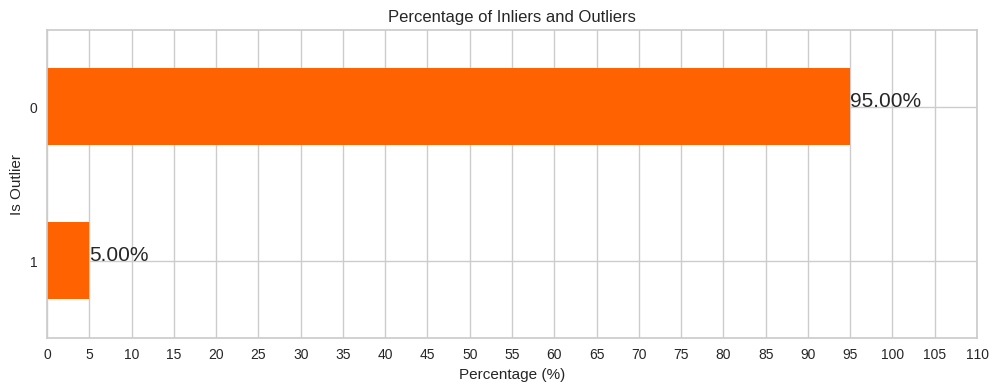

In [ ]:
# Calculer le pourcentage de valeurs aberrantes et non aberrantes
outlier_percentage = customer_df['is_outlier'].value_counts(normalize=True) * 100

# Représentation graphique du pourcentage de valeurs aberrantes et non aberrantes
plt.figure(figsize=(12, 4))
outlier_percentage.plot(kind='barh', color='#ff6200')

# Ajout des étiquettes de pourcentage sur les barres
for index, value in enumerate(outlier_percentage):
    plt.text(value, index, f'{value:.2f}%', fontsize=15)

plt.title('Percentage of Inliers and Outliers')
plt.xticks(ticks=np.arange(0, 115, 5))
plt.xlabel('Percentage (%)')
plt.ylabel('Is Outlier')
plt.gca().invert_yaxis()
plt.show()

> Pour éviter que ces valeurs aberrantes n'affectent de manière significative la qualité des grappes, je les supprimerai de notre ensemble de données principal afin de le préparer à l'analyse par grappes.

In [ ]:
# Supprimer les valeurs aberrantes de l'ensemble de données principal
customer_df = customer_df[customer_df['is_outlier'] == 0]

# Supprimer les colonnes 'outlier_scores' et 'is_outlier'
customer_df = customer_df.drop(columns=['outlier_scores', 'is_outlier'])

# Réinitialiser l'index des données nettoyées
customer_df.reset_index(drop=True, inplace=True)

In [ ]:
customer_df.shape

(104992, 15)

## Analyse de corrélation

Avant de procéder au regroupement KMeans, il est essentiel de vérifier la corrélation entre les caractéristiques de notre ensemble de données. La présence d'une multicolinéarité, où les caractéristiques sont fortement corrélées, peut potentiellement affecter le processus de clustering en ne permettant pas au modèle d'apprendre les modèles sous-jacents réels dans les données.


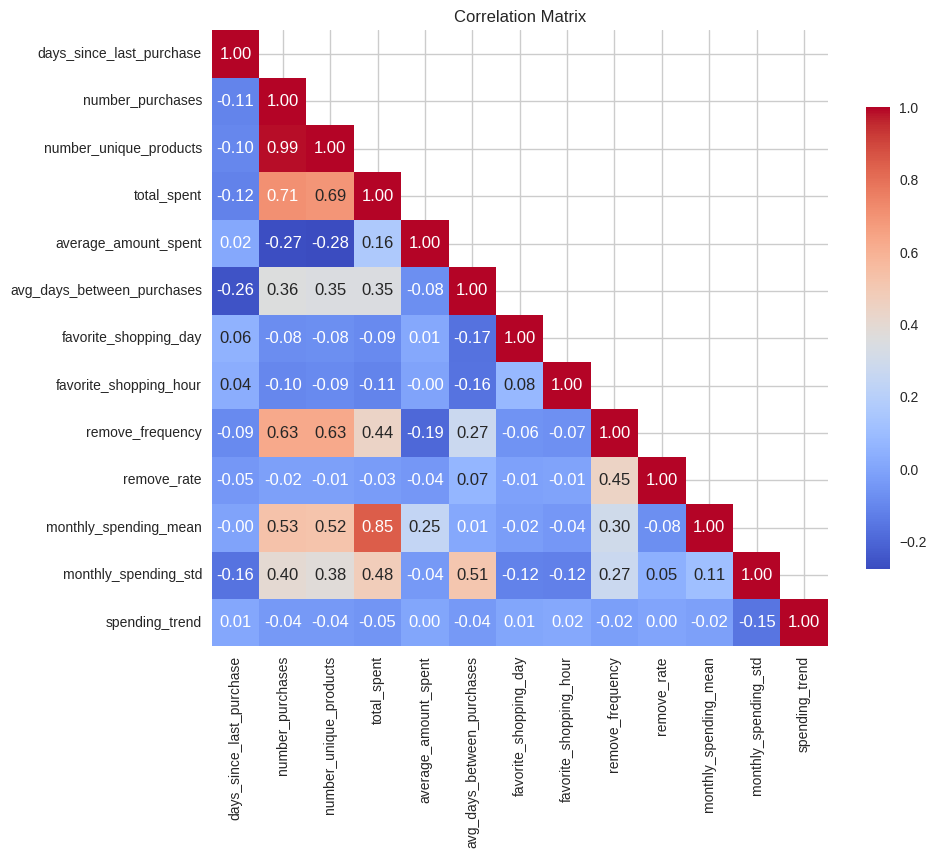

In [ ]:
# Calculer la matrice de corrélation en excluant la colonne "user_id".
corr_matrix = customer_df.drop(['user_id','number_events'], axis=1).corr()

# Créer un masque pour le triangle supérieur
mask = np.triu(np.ones_like(corr_matrix, dtype=bool), k=1)

# Tracer la carte thermique
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, mask=mask, annot=True, fmt='.2f', cmap='coolwarm', square=True, cbar_kws={"shrink": .75})

plt.title('Correlation Matrix')
plt.show()

En examinant la carte thermique, nous pouvons voir que certaines paires de variables ont des corrélations élevées, ce qui indiquent que ces variables évoluent étroitement ensemble, par exemple :

'number_unique_products' et 'number_purchases'

'total_spent' et 'number_purchases'

'number_purchases' et 'remove_frequency'

'total_spent' et 'monthly_spending_mean'

> Avant de passer aux étapes suivantes, nous pouvons utiliser des techniques de réduction de la dimensionnalité telles que l'ACP. Ces techniques permettent de neutraliser l'effet de la multicolinéarité en transformant les caractéristiques corrélées en un nouvel ensemble de variables non corrélées, en préservant la majeure partie de la variance des données d'origine.


## Mise à l'échelle des caractéristiques

Avant de procéder au clustering et à la réduction de la dimensionnalité, il est impératif de mettre nos caractéristiques à l'échelle. Cette étape revêt une importance significative, en particulier dans le contexte des algorithmes basés sur la distance tels que les K-means et les méthodes de réduction de la dimensionnalité qui dépend de la variation des données telles que l'ACP.

Pour garantir une influence équilibrée sur le modèle et révéler les véritables tendances des données, je vais normaliser nos données, c'est-à-dire transformer les caractéristiques pour qu'elles aient une moyenne de 0 et un écart-type de 1.

In [ ]:
customer_df_scaled = customer_df.copy()

# Colonnes qui ont besoin d'être mis à l'échelle
columns_to_scale = customer_df.columns.difference(['user_id', 'favorite_shopping_day'])

# Appliquer StandardScaler aux colonnes sélectionnées
scaler = StandardScaler()
customer_df_scaled[columns_to_scale] = scaler.fit_transform(customer_df_scaled[columns_to_scale])

customer_df_scaled.head()

,user_id,days_since_last_purchase,number_events,number_purchases,number_unique_products,total_spent,average_amount_spent,avg_days_between_purchases,favorite_shopping_day,favorite_shopping_hour,remove_frequency,remove_rate,monthly_spending_mean,monthly_spending_std,spending_trend
0,9794320,0.568599,0.769919,-0.534716,-0.531169,-0.755406,-0.450419,-0.347604,0,-1.458966,1.089150,1.904172,-0.757062,-0.260749,0.026758
1,10079204,1.003861,-0.728608,-0.752620,-0.760666,-0.434777,0.512151,-0.347604,2,-0.487167,-0.657128,-1.006373,-0.349044,-0.260749,0.026758
2,12055855,-0.004114,-0.541293,-0.534716,-0.531169,-0.661147,-0.355003,-0.347604,4,-0.098448,-0.495436,-0.090468,-0.637112,-0.260749,0.026758
3,12936739,-0.645552,-0.648330,-0.752620,-0.760666,-0.335146,0.713861,-0.347604,4,-1.070246,-0.560113,0.432907,-0.222257,-0.260749,0.026758
4,15400971,0.156246,-0.621571,-0.643668,-0.645917,-0.193024,0.413109,-0.347604,4,-0.098448,-0.560113,-0.166793,-0.041399,-0.260749,0.026758


In [ ]:
idx = ["mean", "std"]

pd.DataFrame(customer_df_scaled).describe().round(2).loc[idx, :]

,user_id,days_since_last_purchase,number_events,number_purchases,number_unique_products,total_spent,average_amount_spent,avg_days_between_purchases,favorite_shopping_day,favorite_shopping_hour,remove_frequency,remove_rate,monthly_spending_mean,monthly_spending_std,spending_trend
mean,5.304387e+08,0.0,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,2.70,0.0,0.0,-0.0,-0.0,0.0,0.0
std,8.661082e+07,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.95,1.0,1.0,1.0,1.0,1.0,1.0


## Réduction de la dimensionnalité

Dans cette étape, nous envisageons d'appliquer des techniques de réduction de la dimensionnalité pour simplifier nos données tout en conservant les informations essentielles. Parmi les différentes méthodes telles que PCA, KernelPCA, ICA, ISOMAP, TSNE et UMAP, je choisis PCA (Analyse en Composantes Principales) et KernelPCA. Voici pourquoi :

**PCA :** excellent point de départ car elle permet de capturer les relations linéaires dans les données, ce qui est particulièrement pertinent compte tenu de la multicolinéarité que nous avons identifiée dans notre ensemble de données.

Dans le cas où les premières composantes du PCA ne capturent pas une part significative de la variance, ce qui indique une perte d'informations essentielles, nous pourrions envisager d'explorer d'autres méthodes non linéaires.

**KernelPCA :** Cette méthode peut potentiellement fournir une approche plus nuancée de la réduction de la dimensionnalité, en capturant des modèles complexes que l'ACP pourrait manquer, bien qu'au prix d'un temps de calcul et d'une complexité accrus.





In [ ]:
# user_id comme colonne index
customer_df_scaled.set_index('user_id', inplace=True)
customer_df_scaled.drop('number_events', axis=1, inplace=True)

***PCA :***

In [ ]:
# Appliquer l'ACP
pca = PCA().fit(customer_df_scaled.values)

In [ ]:
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

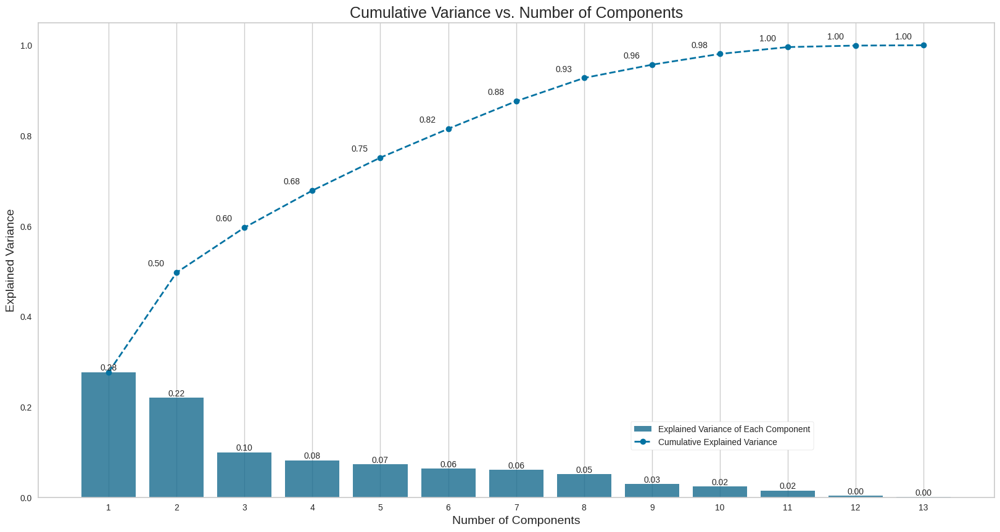

In [ ]:
plt.figure(figsize=(20, 10))

# Diagramme à barres de la variance expliquée de chaque composante
barplot = sns.barplot(x=list(range(1, len(cumulative_explained_variance) + 1)),
                      y=explained_variance_ratio,
                      # color='#fcc36d',
                      alpha=0.8)

# Graphique linéaire de la variance expliquée cumulative
lineplot, = plt.plot(range(0, len(cumulative_explained_variance)), cumulative_explained_variance,
                     marker='o', linestyle='--',
                    #  color='#ff6200',
                     linewidth=2)

plt.xlabel('Number of Components', fontsize=14)
plt.ylabel('Explained Variance', fontsize=14)
plt.title('Cumulative Variance vs. Number of Components', fontsize=18)

# Personnaliser les ticks et la légende
plt.xticks(range(0, len(cumulative_explained_variance)))
plt.legend(handles=[barplot.patches[0], lineplot],
           labels=['Explained Variance of Each Component', 'Cumulative Explained Variance'],
           loc=(0.62, 0.1),
           frameon=True,
           framealpha=1.0,
          #  edgecolor='#ff6200'
           )

# Afficher les valeurs de variance pour les deux graphiques sur les courbes
x_offset = -0.3
y_offset = 0.01
for i, (ev_ratio, cum_ev_ratio) in enumerate(zip(explained_variance_ratio, cumulative_explained_variance)):
    plt.text(i, ev_ratio, f"{ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)
    if i > 0:
        plt.text(i + x_offset, cum_ev_ratio + y_offset, f"{cum_ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)

plt.grid(axis='both')
plt.show()

On a la variance de chaque nouvelle composante, et en ligne la variance cumulée. On voit ici que près de 82% de la variance est comprise dans les 6 premières composantes, et 88% dans les 7 premières.

Pour choisir le nombre optimal de composantes, nous recherchons généralement un point où l'ajout d'une autre composante n'augmente pas de manière significative la variance expliquée cumulée, souvent appelé le "point de coude" de la courbe.

Le graphique montre que l'augmentation de la variance cumulée commence à ralentir après la septième composante (qui capture environ 88 % de la variance totale). Par conséquent, le maintien des sept premiers éléments pourrait être un choix équilibré.

In [ ]:
n_components = 7
pca = PCA(n_components=n_components)

# Ajustement et transformation des données originales dans le nouveau cadre de données de l'ACP
customer_df_pca = pca.fit_transform(customer_df_scaled)

# Création d'un nouveau dataframe à partir du dataframe de l'ACP, avec des colonnes intitulées PC1, PC2, etc.
customer_df_pca = pd.DataFrame(customer_df_pca, columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Aajout de l'index user_id au nouveau dataframe PCA
customer_df_pca.index = customer_df_scaled.index

customer_df_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7
user_id,,,,,,,
9794320,-1.220829,-2.541808,-1.507854,-1.039809,1.515307,-0.353740,-1.665926
10079204,0.735216,-1.507488,0.905215,0.239367,-0.510380,-0.208475,-0.825984
12055855,1.798332,0.160111,-0.466678,0.121503,-0.313818,0.059372,-0.167412
12936739,1.660055,0.205826,0.036527,0.948287,0.848472,0.390216,-0.738220
15400971,1.660360,0.314040,0.459204,0.363693,0.161962,0.022868,-0.186477


Intéressons nous maintenant à nos fameuses composantes. La formule de ce calcul nous est donnée par l'attribut `components_`

In [ ]:
# Créez le DataFrame de la composante ACP
pcs = pd.DataFrame(pca.components_)
pcs.columns = customer_df_scaled.columns
pcs.index = [f"PC{i}" for i in range(1, n_components+1)]
pcs.T

,PC1,PC2,PC3,PC4,PC5,PC6,PC7
days_since_last_purchase,0.091535,-0.033721,0.196608,-0.389982,-0.092441,-0.378313,-0.426815
number_purchases,-0.347286,0.305301,-0.022782,-0.168636,-0.206200,0.016656,0.003322
number_unique_products,-0.342538,0.303979,-0.025563,-0.184903,-0.209640,0.013391,0.005504
total_spent,-0.329002,0.282082,0.316095,0.089625,0.096685,0.009228,0.030113
average_amount_spent,0.052069,-0.040800,0.504907,0.330186,0.507691,0.014119,0.028612
avg_days_between_purchases,-0.239461,0.088796,-0.286524,0.441313,-0.018979,0.130160,0.032417
favorite_shopping_day,0.628435,0.768287,-0.062776,0.094737,-0.002266,0.022988,-0.024411
favorite_shopping_hour,0.088072,-0.012298,0.051785,-0.262513,-0.019308,-0.129481,0.898391
remove_frequency,-0.263776,0.232802,-0.262730,-0.289924,0.302384,-0.047618,-0.032143
remove_rate,-0.036799,0.028378,-0.390269,-0.215590,0.722921,-0.101612,-0.035608


<Axes: >

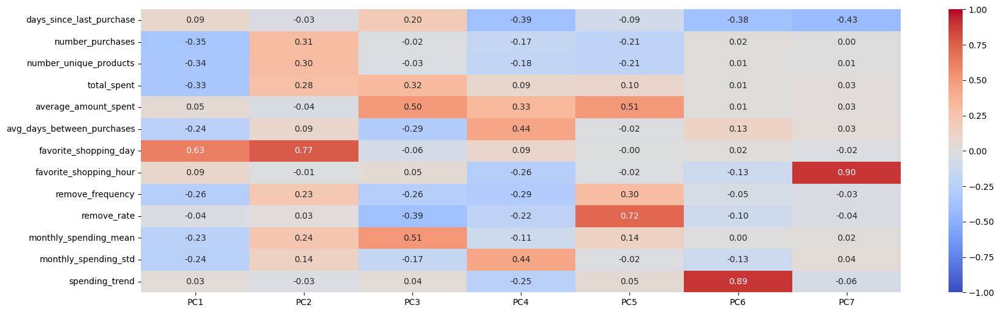

In [ ]:
fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [ ]:
# Graphe des corrélations pour les deux premières composantes principales
x_y = (0,1)
correlation_graph_interactive(pca, x_y, customer_df_scaled.columns)

D'après la heatmap et le graph de correlation, les variables les plus corrélées positivement à PC1 sont :
'number_purchases' ;
'number_unique_products' ;
'total_spent';
 mais on a aussi la variable 'favorite_shopping_day' qui est corrélée négativement à PC1.
 Quant à PC2, la variable la plus corrélées est 'favorite_shopping_day'.

In [ ]:
x_y = (2,3)
correlation_graph_interactive(pca, x_y, customer_df_scaled.columns, labels=True)

D'après la heatmap et le graph de correlation, les variables les plus corrélées positivement à PC3 sont :
'remove_rate' ;
et pour les variables corrélées négativement on a 'monthly_spending_mean'; 'average_amount_spent'.
 Quant à PC4, la variable la plus corrélée positivement est
'days_since_last_purchase' and négativement on a 'avg_days_between_purcahses'; 'monthly_spending_std'; 'average_amout_spent'.

***KernelPCA :***

L'ACP à noyau implique le calcul d'une matrice à noyau, qui peut nécessiter une grande quantité de mémoire. La matrice du noyau a une taille de 𝑁×𝑁 où 𝑁 est le nombre d'échantillons. Dans notre cas, la matrice du noyau aurait la taille suivante
(104 992×104 992) éléments.
Le calcul des valeurs propres et des vecteurs propres pour une matrice de noyau aussi grande est très exigeant et a provoqué un plantage en raison du dépassement des capacités de traitement de ma machine.

Je vais donc utiliser deux stratégies pour traiter notre ensemble de données :
1. Utiliser un petit sous-ensemble de données pour déterminer le nombre optimal de composants à l'aide de KernelPCA
2. Utiliser une méthode de noyau approximatif :

    Une fois que j'ai déterminé le nombre optimal de composantes à l'aide de KernelPCA, on va transformer l'ensemble de notre jeu de données en utilisant la méthode de noyau approximatif adéquate pour en réduire les dimensions. Le choix de cette méthode dépend du kernel selectionné comme meilleur paramètre lors de la GridSearch.
    
    On va ensuite utiliser cet ensemble de données transformé pour d'autres analyses, telles que le regroupement à l'aide de KMeans.

> ***RBFSampler*** permet d'effectuer des transformations non linéaires similaires à celles de KernelPCA. Il approxime le mappage des caractéristiques d'un noyau RBF (Radial Basis Function) à l'aide de caractéristiques aléatoires de Fourier, ce qui permet d'appliquer des algorithmes linéaires à des données qui sont mappées dans un espace de plus grande dimension, de manière similaire à l'effet de KernelPCA.

In [ ]:
# 1.
# J'utiliserai un sous-ensemble aléatoire plus petit de nos données pour effectuer l'ACP à noyau.
subset_size = 1000
subset_df = customer_df_scaled.sample(n=subset_size, random_state=42)

# Define a range of parameters
param_grid = {
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'gamma': [0.01, 0.1, 1, 10],
    'degree': [2, 3, 4]
}

# Scoreur personnalisé pour utiliser la variance expliquée
def explained_variance_scorer(estimator, X):
    transformed = estimator.fit_transform(X)
    explained_variance = np.var(transformed, axis=0).sum() / np.var(X, axis=0).sum()
    return explained_variance

# Initialiser KernelPCA
kpca = KernelPCA(fit_inverse_transform=True, random_state=42)

# Recherche en grille avec validation croisée
grid_search = GridSearchCV(kpca, param_grid, scoring=explained_variance_scorer, cv=3, verbose=1)
grid_search.fit(subset_df)

best_params = grid_search.best_params_


In [ ]:
# Best parameters
print("Best parameters:", best_params)

Best parameters: {'degree': 4, 'gamma': 10, 'kernel': 'poly'}


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/decomposition/_kernel_pca.py:415: LinAlgWarning: Ill-conditioned matrix (rcond=2.64138e-24): result may not be accurate.
  self.dual_coef_ = linalg.solve(K, X, assume_a="pos", overwrite_a=True)


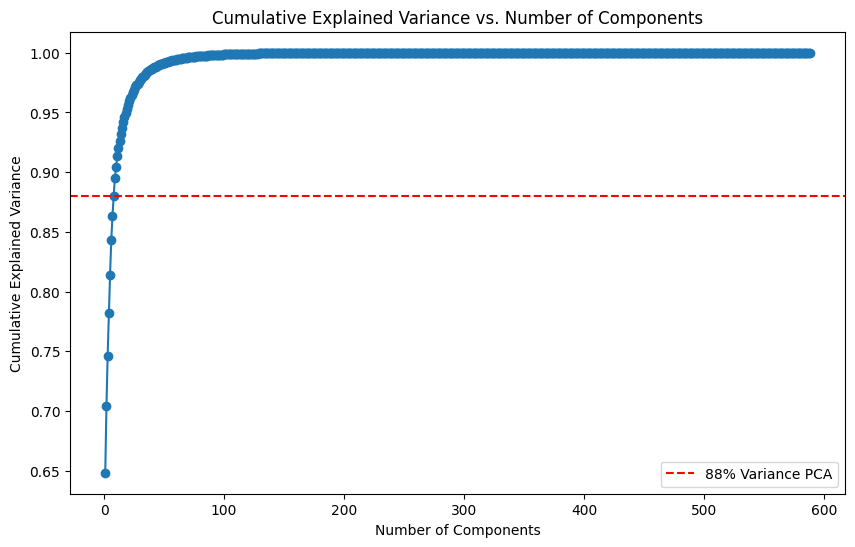

In [ ]:
# Appliquer KernelPCA
kernel_pca = KernelPCA(kernel=best_params['kernel'],
                 gamma=best_params.get('gamma', None),
                 degree=best_params.get('degree', None),
                 fit_inverse_transform=True,
                 random_state=42)
subset_kpca = kernel_pca.fit(subset_df)

# Valeurs propres
eigenvalues = kernel_pca.eigenvalues_

# Variance expliquée
explained_variance = np.cumsum(eigenvalues) / np.sum(eigenvalues)

# Tracer la variance expliquée cumulative
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of Components')
plt.axhline(y=0.88, color='r', linestyle='--', label='88% Variance PCA')
plt.legend()
plt.show()


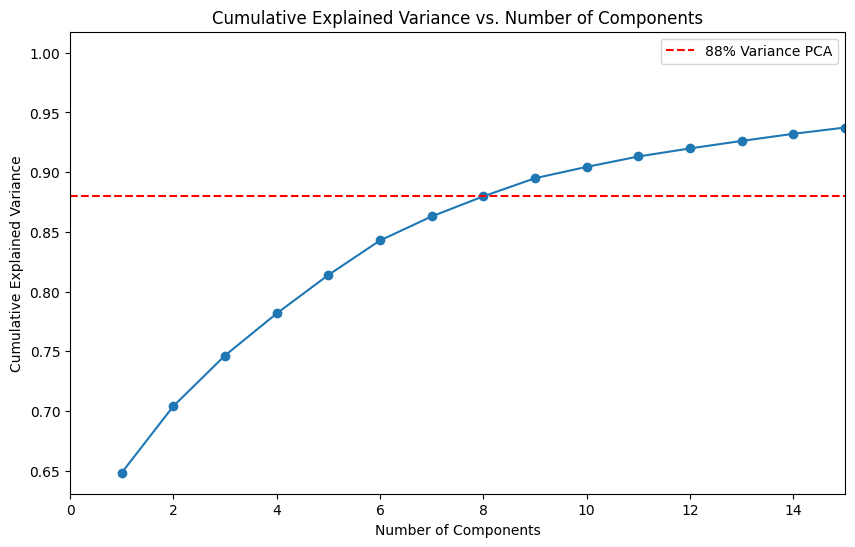

In [ ]:
# ZOOM IN
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of Components')
plt.xlim(0, 15)
plt.axhline(y=0.88, color='r', linestyle='--', label='88% Variance PCA')
plt.legend()
plt.show()

On a la variance de chaque nouvelle composante, la variance cumulée. On voit ici que 88% de la variance est atteinte dans les 8 premières composantes.
On se contentera de garder le nombre de composantes qui nous permet d'atteindre 88% comme pour le PCA. Par conséquent, le maintien des huit premiers éléments pourrait être un choix équilibré.

Puisque le meilleur noyau est polynomial (poly), on va utiliser **PolynomialCountSketc**h** de sklearn.kernel_approximation comme méthode approximative pour KernelPCA. PolynomialCountSketch fournit une approximation du noyau polynomial en utilisant des caractéristiques de Fourier aléatoires, et convient aux grands ensembles de données.

In [ ]:
# Si le meilleur noyau était 'rbf'

# optimal_components = 8
# # Apply RBFSampler with the optimal number of components (e.g., 7)
# rbf_sampler = RBFSampler(n_components=optimal_components, gamma=0.1)
# customer_df_rbf = rbf_sampler.fit_transform(customer_df_scaled)

# # Convert the transformed data back to a DataFrame
# customer_df_kernel = pd.DataFrame(customer_df_rbf, columns=[f'Feature{i+1}' for i in range(optimal_components)])

# # Maintenant customer_df_kernel contient la transformation non linéaire similaire à KernelPCA.
# customer_df_kernel.head()


In [ ]:
# 2. Appliquer la méthode de noyau approximatif
optimal_components = 8

# Define the PolynomialCountSketch based on the best parameters
poly_sketch = PolynomialCountSketch(degree=4, gamma=10, n_components=100, random_state=42)

# Apply the PolynomialCountSketch and then PCA
pipeline = Pipeline([
    ('poly_sketch', poly_sketch),
    ('pca', PCA(n_components=optimal_components, random_state=42))
])

# Fit and transform the full dataset
customer_df_poly_pca = pipeline.fit_transform(customer_df_scaled.values)

# Convert the transformed data back to a DataFrame
customer_df_kernel = pd.DataFrame(customer_df_poly_pca, columns=[f'Feature{i+1}' for i in range(optimal_components)])

# Aajout de l'index user_id au nouveau dataframe PCA
customer_df_kernel.index = customer_df_scaled.index

# customer_df_poly_pca is now your transformed dataframe
print(customer_df_kernel.shape)

(104992, 8)


In [ ]:
customer_df_kernel.head()

,Feature1,Feature2,Feature3,Feature4,Feature5,Feature6,Feature7,Feature8
0,11796.502146,-14787.802002,-16696.910135,-219.943228,8925.007085,11587.170294,-3758.310176,-3657.416325
1,10492.626921,-14942.677647,-16513.552720,-875.935773,7998.956843,10745.781747,-3210.299787,-3256.689448
2,10901.995615,-16858.299779,-17546.508961,-887.662483,9823.192591,10060.568830,-53.162418,-205.686205
3,7602.553872,-15827.951484,-13481.904991,315.291577,9707.651985,10360.985928,-5177.118175,1595.753820
4,10982.405826,-17325.061989,-17888.427049,-2140.669108,7501.554205,7628.645908,-311.471131,-263.687625


## Clustering

L'analyse de cluster est un processus itératif qui divise les données en groupes sur la base d'attributs similaires.

On effectuera un regroupement (par exemple, K-means) sur 3 données:
    les données originales, les données transformées avec PCA et les données transformées en utilisant le KERNEL.

Dans cette étude trois algorithmes seront comparés: *K-means clustering, the Gaussian mixture model (GMM), density-based spatial clustering of applications with noise (DBSCAN)*

- *K-means*: est un algorithme de regroupement basé sur les centroïdes ou sur les partitions. un algorithme d'apprentissage automatique non supervisé qui regroupe les données en un nombre spécifié de groupes (K) en minimisant l'inertie. Utilisation de méthodes telles que la **méthode du coude** et l'analyse de la **silhouette** pour estimer le nombre optimal de groupes.

- *DBSCAN* : DBScan est un algorithme de regroupement basé sur la densité. L'élément clé de cet algorithme est que le voisinage de chaque point d'une groupe situé dans un rayon donné (R) doit comporter un nombre minimum de points (M). Cet algorithme s'est avéré extrêmement efficace pour détecter les valeurs aberrantes et gérer le bruit.

- *GMM*: Les modèles de mélange gaussien sont des modèles de distribution, des modèles probabilistes et utilisent l'approche de regroupement souple pour distribuer les points dans différents groupes.

Pour examiner de plus près la qualité de nos algorithmes de clustering, j'utiliserai les mesures suivantes :

- **Score de silhouette** : Mesure permettant d'évaluer la distance de séparation entre les clusters. Des valeurs élevées indiquent une meilleure séparation des grappes. Il est compris entre -1 et 1.

- **Score Calinski Harabasz** : Ce score est utilisé pour évaluer la dispersion entre et au sein des clusters. Un score élevé indique que les clusters sont mieux définies.

- **Score de Davies Bouldin** : il évalue la similarité moyenne entre chaque cluster et son cluster le plus similaire. Des valeurs plus faibles indiquent une meilleure séparation des clusters.


***K-means :***

1.  Pour déterminer le nombre optimal de clusters (k) pour segmenter les clients, j'explorerai deux méthodes renommées : la *méthode du coude* et La méthode des *silhouettes*. Il est courant d'utiliser les deux méthodes dans la pratique pour corroborer les résultats.

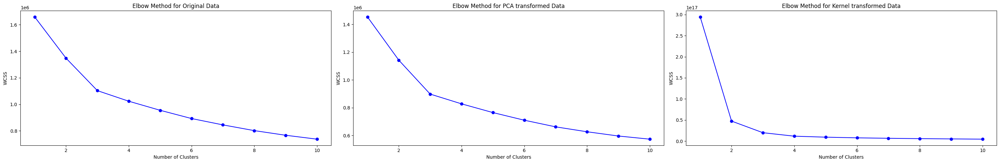

In [ ]:
plot_elbow_method(customer_df_scaled ,customer_df_pca, customer_df_kernel)

> Sur les graphiques, nous n'avons pas de point de coude très distinct, ce qui est courant dans les données du monde réel. Nous pouvons voir que l'inertie continue à diminuer de manière significative jusqu'à k=5, ce qui indique que la valeur optimale de k pourrait se situer entre 3 et 7. Pour choisir la meilleure valeur de k dans cette fourchette, nous allons utiliser l'analyse de la silhouette.

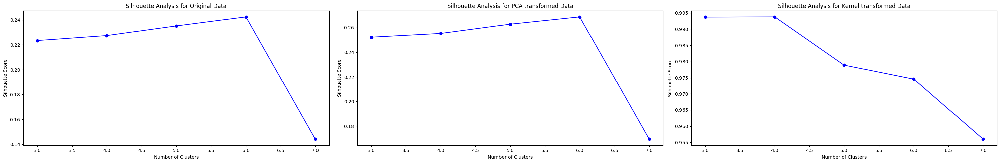

In [ ]:
# Effectuer une analyse Silhouette pour une fourchette de valeurs k et visualiser les résultats.
plot_silhouette_analysis(3, 7, customer_df_scaled ,customer_df_pca, customer_df_kernel)

> En sachant qu'un score de silhouette plus élevé indique une meilleure configuration de regroupement, il est clair que le choix de ( k = 5 ) pour les données originales et les données transformées avec PCA est la meilleure option. Quant aux données transformées avec le kernel le choix de ( k = 3 ) est la meilleure option. Ce choix nous permet d'obtenir des groupes plus homogènes et mieux définies, ce qui rend notre solution de regroupement plus solide et plus fiable.

2. Dans cette étape, je vais appliquer l'algorithme de regroupement K-means pour segmenter les clients en différents groupes sur la base de leurs comportements d'achat et d'autres caractéristiques, en utilisant le nombre optimal de groupes déterminé à l'étape précédente.

In [ ]:
# Appliquer KMeans sur les données originales en utilisant la valeur optimale k = 5
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=10, max_iter=100, random_state=42)
kmeans.fit(customer_df_scaled.values)

labels_kmeans = kmeans.labels_

# Appliquer KMeans sur les données transformées avec PCA en utilisant la valeur optimale k = 5
kmeans_pca = KMeans(n_clusters=5, init='k-means++', n_init=10, max_iter=100, random_state=42)
kmeans_pca.fit(customer_df_pca.values)

labels_kmeans_pca = kmeans_pca.labels_

# Appliquer KMeans sur les données transformées avec KERNEL en utilisant la valeur optimale k = 3
kmeans_kernel = KMeans(n_clusters=3, init='k-means++', n_init=10, max_iter=100, random_state=42)
kmeans_kernel.fit(customer_df_kernel.values)

labels_kmeans_kernel = kmeans_kernel.labels_

# Ajoutez les nouvelles étiquettes de cluster aux différentes version de l'ensemble de données.
customer_df_scaled['cluster'] = labels_kmeans
customer_df_pca['cluster'] = labels_kmeans_pca
customer_df_kernel['cluster'] = labels_kmeans_kernel


3. Après avoir déterminé le nombre optimal de clusters à l'aide des analyses du coude et de la silhouette, je passe à l'étape d'évaluation de la qualité des clusters formés. Cette étape est essentielle pour valider l'efficacité du clustering et s'assurer que les clusters sont cohérents et bien séparés.

Choix des 3 premiers PC pour créer une visualisation en 3D pour les données transformées avec PCA et KERNEL. Cela nous permettra d'inspecter visuellement la qualité de la séparation des clusters dans une certaine mesure

In [ ]:
# Create the subplots
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]])

# Create the scatter plots
fig1 = px.scatter_3d(customer_df_pca, x='PC1', y='PC2', z='PC3', color='cluster',
                     title='Données transformées PCA',
                     labels={'PC1': 'PC1', 'PC2': 'PC2', 'PC3': 'PC3'})

fig2 = px.scatter_3d(customer_df_kernel, x='Feature1', y='Feature2', z='Feature3', color='cluster',
                     title='Données transformées KERNEL',
                     labels={'Feature1': 'Feature1', 'Feature2': 'Feature2', 'Feature3': 'Feature3'})

# Add the traces to the subplots
for trace in fig1.data:
    fig.add_trace(trace, row=1, col=1)

for trace in fig2.data:
    fig.add_trace(trace, row=1, col=2)

# Update layout
fig.update_layout(height=600, width=1400, title_text="K-means: Diagramme 3D de dispersion des clusters")
fig.show()


On va utiliser un diagramme à barres pour visualiser le pourcentage de clients dans chaque groupe. Ce qui permet de comprendre si les groupes sont équilibrés et significatifs

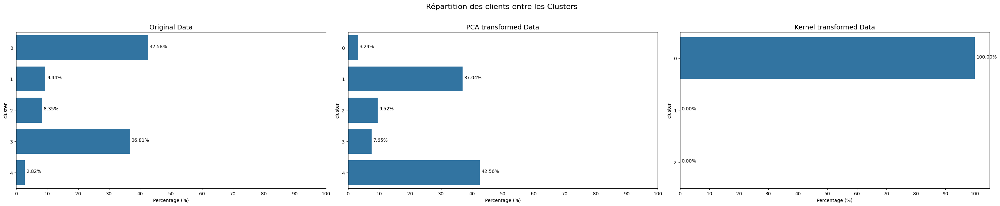

In [ ]:
percentage_clusters_graphs('K-means',customer_df_scaled ,customer_df_pca, customer_df_kernel)

> Nous constatons pour les données transformées avec KERNEL que près de 100 % des points de données sont affectés à un groupe tandis que les autres sont proches de 0 %, cela indique généralement que les points de données sont linéairement dépendants ou très proches les uns des autres dans l'espace transformé.
 Avec l'ACP, les 7 premières composantes atteignent 88 % de variance expliquée, ce qui indique que vos données présentent des modèles linéaires forts qui peuvent être capturés efficacement par quelques composantes principales.

On va calculer les métriques d'évaluation définis plus haut:

In [ ]:
df_scores_kmeans = evaluate_metrics(customer_df_scaled, 'None', 'K-means')
df_scores_kmeans = evaluate_metrics(customer_df_pca, 'PCA', 'K-means',df_scores=df_scores_kmeans)

df_scores_kmeans

In [ ]:
df_scores_kmeans

,Transformation,Algorithms,Number of Clusters,Silhouette Score,Calinski Harabasz Score,Davies Bouldin Score
0,None,K-means,5,0.235128,19346.581557,1.557568
1,PCA,K-means,5,0.262804,23618.519280,1.443374


Résultats:
- Score Silhouette : L'application de PCA avant k-means a légèrement amélioré le score silhouette de 0.235128 à 0.262804, suggérant une meilleure séparation des clusters.
- Score Calinski Harabasz : Le score Calinski Harabasz a augmenté de 19346.581557 à 23618.519280 après la transformation PCA, indiquant une augmentation de la dispersion des clusters.
- Score Davies Bouldin : Le score Davies Bouldin a diminué de 1.557568 à 1.443374 avec PCA, reflétant une amélioration de la qualité des clusters.

>  On peut dire que PCA a amélioré le clustering K-means. Les indicateurs montrent une meilleure qualité des clusters après l'application de PCA, avec une séparation plus nette (score silhouette amélioré), une meilleure dispersion des clusters (score Calinski Harabasz augmenté), et une réduction de la moyenne des rapports de dispersion intra-cluster à la dispersion inter-cluster (score Davies Bouldin diminué).



In [ ]:
# Supprimer les clusters définis par K-means
customer_df_scaled.drop('cluster', axis=1, inplace=True)
customer_df_pca.drop('cluster', axis=1, inplace=True)
customer_df_kernel.drop('cluster', axis=1,inplace=True)

***GMM :***

1.  Pour déterminer le nombre optimal de clusters (n) pour segmenter les clients, j'explorerai deux différentes méthodes : La méthode des *Silhouettes* et la *Distance entre les GMM*.

Étant donné que cet algorithme ne garantit que l'atteinte d'un point optimal local, mais ne garantit pas que cet optima local est également l'optima global, nous devons tenir compte de sa nature non déterministe. La façon la plus simple d'y remédier est d'exécuter la procédure d'ajustement plusieurs fois, et de considérer la valeur moyenne et l'écart-type pour chaque configuration.


In [ ]:
# Returns the set of X configurations with shorter distance
def SelBest(arr: list, X: int) -> list:
    dx = np.argsort(arr)[:X]
    return arr[dx]

def plot_gmm_silhouette(*datasets, n_clusters_range=np.arange(2, 7), iterations=10):
    methods = ['Original Data', 'PCA transformed Data', 'Kernel transformed Data']
    n_datasets = len(datasets)

    fig, axs = plt.subplots(1, n_datasets, figsize=(5 * n_datasets, 6), sharey=True)
    if n_datasets == 1:
        axs = [axs]

    for idx, data in enumerate(datasets):
        sils = []
        sils_err = []

        for n in n_clusters_range:
            tmp_sil = []
            for _ in range(iterations):
                gmm = GMM(n, n_init=2, random_state=42).fit(data)
                labels = gmm.predict(data)
                sil = silhouette_score(data, labels, metric='euclidean')
                tmp_sil.append(sil)

            val = np.mean(SelBest(np.array(tmp_sil), int(iterations / 5)))
            err = np.std(tmp_sil)
            sils.append(val)
            sils_err.append(err)

        axs[idx].errorbar(n_clusters_range, sils, yerr=sils_err)
        axs[idx].set_title(f"{methods[idx]}", fontsize=14)
        axs[idx].set_xticks(n_clusters_range)
        axs[idx].set_xlabel("Number of Clusters")
        axs[idx].set_ylabel("Mean Silhouette Score")

    plt.suptitle("Silhouette Scores for GMM Clustering", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

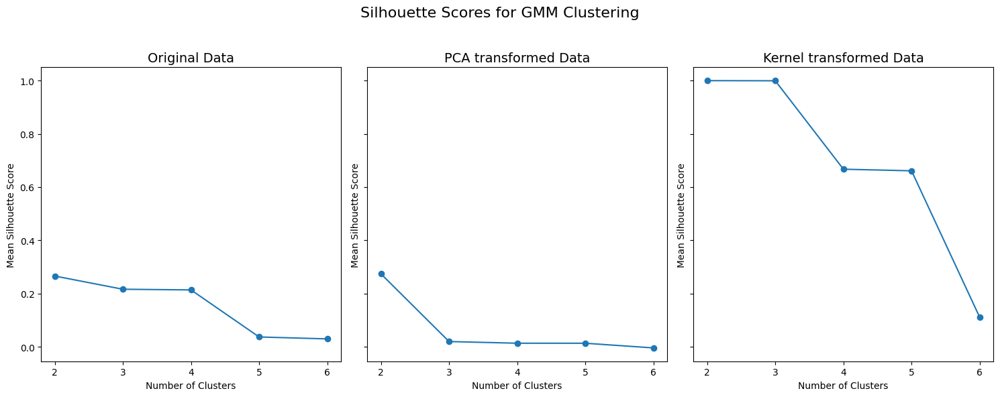

In [ ]:
plot_gmm_silhouette(customer_df_scaled, customer_df_pca, customer_df_kernel)

> Il s'avère que nous obtenons le meilleur score avec 2 clusters. Nous devons également tenir compte du fait que la configuration à trois clusters pour les données d'origine est presque aussi bonne. Ce score ne nous donne donc pas un résultat clair.
On remarque pour les données transformées en KERNEL sont à 1 ce qui laisse à croire que encore ça sera focalisé sur un seul cluster, ce qu'on verifiera un peu plus bas.

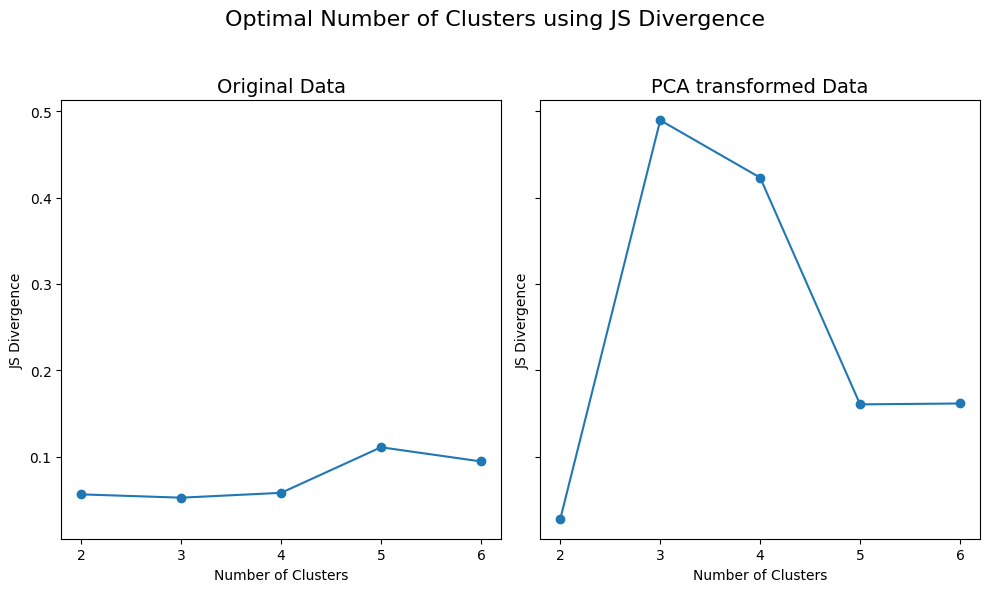

In [ ]:
plot_gmm_js_divergence(customer_df_scaled, customer_df_pca)

> La configuration avec 2 clusters est la plus conservatrice pour les données d'origine. (on a testé 3 et 4 clusters aussi en annexe les résultats étaient moins bons que pour 2 clusters)
> La partie intéressante du 2ème graphique est le changement soudain de la distance que l'on observe après avoir passé la configuration à 2 clusters pour les données transformées aavec PCA: la distance moyenne augmentent considérablement.
Cela signifie qu'à partir de 2 clusters, les GMMs des deux ensembles sont beaucoup plus différents (puisque la distance est beaucoup plus grande) et aussi moins stables (puisque la bande d'erreur est beaucoup plus grande).
Nous pouvons dire que la bonne configuration, qui tient compte à la fois de la quantité d'informations incluses (=le plus grand nombre possible de clusters) et de la stabilité de la procédure d'ajustement (=la plus faible distance possible entre les GMMs), est celle qui prend en compte 2 clusters.

2. Dans cette étape, je vais appliquer l'algorithme de regroupement GMM pour segmenter les clients en utilisant le nombre optimal de groupes déterminé à l'étape précédente n = 2.

In [ ]:
# Appliquer GMM sur les  données originales en utilisant la valeur optimale n
gmm = GMM(n_components=4, random_state=42)
labels_gmm = gmm.fit_predict(customer_df_scaled.values)

# Appliquer GMM sur les données transformées avec PCA en utilisant la valeur optimale n
gmm_pca = GMM(n_components=2, random_state=42)
labels_gmm_pca = gmm_pca.fit_predict(customer_df_pca.values)

# Appliquer GMM sur les données transformées avec KERNEL en utilisant la valeur optimale n
gmm_kernel = GMM(n_components=3, random_state=42)
labels_gmm_kernel = gmm_kernel.fit_predict(customer_df_kernel.values)

# Ajoutez les nouvelles étiquettes de cluster aux différents ensembles de données.
customer_df_scaled['cluster'] = labels_gmm
customer_df_pca['cluster'] = labels_gmm_pca
customer_df_kernel['cluster'] = labels_gmm_kernel


3. Après avoir déterminé le nombre optimal de clusters, je passe à l'étape d'évaluation de la qualité des clusters formés. Cette étape est essentielle pour valider l'efficacité du clustering et s'assurer que les clusters sont cohérents et bien séparés.

Choix des 3 premiers PC pour créer une visualisation en 3D. Cela nous permettra d'inspecter visuellement la qualité de la séparation des clusters dans une certaine mesure

In [ ]:
# Create the subplots
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]])

# Create the scatter plots
fig1 = px.scatter_3d(customer_df_pca, x='PC1', y='PC2', z='PC3', color='cluster',
                     title='Données transformées PCA',
                     labels={'PC1': 'PC1', 'PC2': 'PC2', 'PC3': 'PC3'})

fig2 = px.scatter_3d(customer_df_kernel, x='Feature1', y='Feature2', z='Feature3', color='cluster',
                     title='Données transformées KERNEL',
                     labels={'Feature1': 'Feature1', 'Feature2': 'Feature2', 'Feature3': 'Feature3'})

# Add the traces to the subplots
for trace in fig1.data:
    fig.add_trace(trace, row=1, col=1)

for trace in fig2.data:
    fig.add_trace(trace, row=1, col=2)

# Update layout
fig.update_layout(height=600, width=1400, title_text="GMM : Diagramme 3D de dispersion des clusters")
fig.show()

On va utiliser un diagramme à barres pour visualiser le pourcentage de clients dans chaque groupe. Ce qui permet de comprendre si les groupes sont équilibrés et significatifs

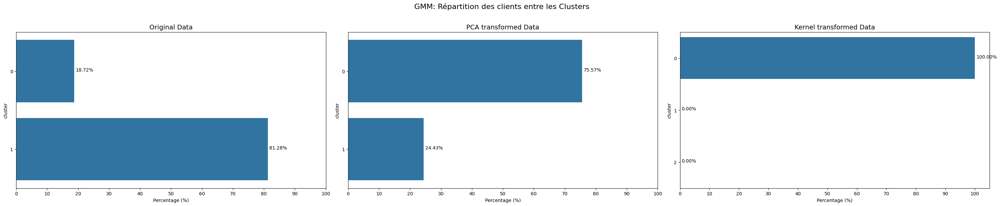

In [ ]:
percentage_clusters_graphs('GMM', customer_df_scaled, customer_df_pca, customer_df_kernel)

Les résultas pour les données transformées Kernel vérifie notre hypothèse faite un peu plus haut. Puisque les données sont linéairement dépendants le Kernel n'est pas une bonne idée.

On va calculer les métriques d'évaluation définis plus haut:

In [ ]:
df_scores_gmm = evaluate_metrics(customer_df_scaled, 'None', 'GMM')
df_scores_gmm = evaluate_metrics(customer_df_pca, 'PCA', 'GMM',df_scores=df_scores_gmm)

df_scores_gmm

In [ ]:
df_scores_gmm

,Transformation,Algorithms,Number of Clusters,Silhouette Score,Calinski Harabasz Score,Davies Bouldin Score
0,None,GMM,2,0.265904,14542.564263,2.188693
1,PCA,GMM,2,0.274076,17104.841718,2.245840


> Les résultats montrent que l'application de la transformation PCA avant le clustering GMM a légèrement amélioré le score silhouette (de 0.265904 à 0.274076) et le score Calinski Harabasz (de 14542.564263 à 17104.841718), indiquant une meilleure qualité des clusters. Cependant, le score Davies Bouldin a légèrement augmenté (de 2.188693 à 2.245840), ce qui suggère une légère augmentation de la moyenne des rapports de dispersion intra-cluster à la dispersion inter-cluster. Globalement, l'application de PCA a amélioré certains aspects du clustering, mais pas tous.

**Résultats :**

In [ ]:
df_scores = pd.concat([df_scores_kmeans, df_scores_gmm], ignore_index=True)

df_scores

,Transformation,Algorithms,Number of Clusters,Silhouette Score,Calinski Harabasz Score,Davies Bouldin Score
0,None,K-means,5,0.235128,19346.581557,1.557568
1,PCA,K-means,5,0.262804,23618.519280,1.443374
2,None,GMM,2,0.265904,14542.564263,2.188693
3,PCA,GMM,2,0.274076,17104.841718,2.245840


Globalement, l'application de PCA avant le clustering améliore la qualité des clusters pour les deux algorithmes.
Pour déterminer quel algorithme est meilleur entre K-means et GMM, comparons leurs scores respectifs après l'application de PCA :

Silhouette Score: Un score plus élevé indique des clusters mieux définis.

- K-means avec PCA : 0.262804
- GMM avec PCA : 0.274076
- Avantage : GMM

Calinski Harabasz Score: Un score plus élevé indique des clusters plus distincts.

- K-means avec PCA : 23618.519280
- GMM avec PCA : 17104.841718
- Avantage : K-means

Davies Bouldin Score: Un score plus faible indique des clusters moins dispersés.

- K-means avec PCA : 1.443374
- GMM avec PCA : 2.245840
- Avantage : K-means

**Conclusion** :
>Bien que GMM ait un meilleur Silhouette Score, K-means a des scores Calinski Harabasz et Davies Bouldin plus favorables après l'application de PCA. En général, ces scores suggèrent que K-means offre des clusters plus distincts et moins dispersés que GMM. Ainsi, **K-means semble globalement fournir de meilleurs résultats de clustering par rapport à GMM dans ce cas particulier**.

In [ ]:
# On va donc continuer l'analyse en utilisant les clusters résultant du K-means
customer_df['cluster'] = labels_kmeans_pca

In [ ]:
customer_df.to_csv('customer_df_cluster_kmeans.csv', index=False)

## Analyse des clusters et établissement des profiles

Dans cette section, je vais analyser les caractéristiques de chaque cluster identifié par l'algorithme K-means afin de comprendre les comportements et les préférences distincts des différents segments de clientèle et de dresser le profil de chaque groupe afin d'identifier les traits clés qui définissent les clients de chaque groupe.

In [2]:
customer_df = pd.read_csv('customer_df_cluster_kmeans.csv')

In [ ]:
from tabulate import tabulate

# Assuming customer_df is your dataframe
# Regroupement par cluster et calcul des valeurs moyennes (centroïdes)
centroids = customer_df.groupby('cluster').mean().reset_index()

# Exclure la colonne "Cluster" de la mise à l'échelle
features = centroids.columns.difference(['cluster','user_id','number_events'])

# Appliquer StandardScaler aux centroïdes
scaler = StandardScaler()
centroids[features] = scaler.fit_transform(centroids[features])

# Convert centroids DataFrame to a list of lists for tabulate
centroids_list = centroids.values.tolist()

# Define headers
headers = centroids.columns.tolist()

# Create and print the table
print(tabulate(centroids_list, headers=headers, tablefmt='grid'))

+-----------+-------------+----------------------------+-----------------+--------------------+--------------------------+---------------+------------------------+------------------------------+-------------------------+--------------------------+--------------------+---------------+-------------------------+------------------------+------------------+
|   cluster |     user_id |   days_since_last_purchase |   number_events |   number_purchases |   number_unique_products |   total_spent |   average_amount_spent |   avg_days_between_purchases |   favorite_shopping_day |   favorite_shopping_hour |   remove_frequency |   remove_rate |   monthly_spending_mean |   monthly_spending_std |   spending_trend |
+===========+=============+============================+=================+====================+==========================+===============+========================+==============================+=========================+==========================+====================+===============+======

In [9]:
customer_df[(customer_df['cluster']==3) ]

,user_id,days_since_last_purchase,number_events,number_purchases,number_unique_products,total_spent,average_amount_spent,avg_days_between_purchases,favorite_shopping_day,favorite_shopping_hour,remove_frequency,remove_rate,monthly_spending_mean,monthly_spending_std,spending_trend,cluster
37,43695999,58,67,25,25,125.82,5.032800,6.000000,3,9,42,0.626866,62.910,29.514637,-41.740,3
44,47076222,4,98,38,34,109.26,2.875263,30.250000,4,18,60,0.612245,27.315,12.783053,2.828,3
51,50142794,26,35,14,14,43.68,3.120000,37.000000,0,9,21,0.600000,14.560,4.494430,-4.140,3
58,54710988,14,113,26,20,120.18,4.622308,31.666667,1,20,87,0.769912,40.060,15.725126,1.630,3
62,58556296,24,42,15,15,41.95,2.796667,23.500000,2,11,27,0.642857,20.975,17.090771,-24.170,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95963,608228354,25,94,31,31,196.10,6.325806,1.000000,4,8,63,0.670213,98.050,87.242835,-123.380,3
95971,608232807,9,19,8,8,68.10,8.512500,10.500000,3,15,11,0.578947,34.050,18.526198,-26.200,3
96165,608459001,11,66,26,21,52.12,2.004615,5.666667,4,6,40,0.606061,26.060,9.913637,-14.020,3
96262,608547794,23,40,9,9,75.99,8.443333,2.500000,3,6,31,0.775000,37.995,33.806775,47.810,3


In [3]:
# Regroupement par cluster et calcul des valeurs moyennes (centroïdes)
centroids = customer_df.groupby('cluster').mean().reset_index()

# Exclure la colonne "Cluster" de la mise à l'échelle
features = centroids.columns.difference(['cluster','user_id'])

# Appliquer StandardScaler aux centroïdes
scaler = StandardScaler()
centroids[features] = scaler.fit_transform(centroids[features])

# Définir le nombre de clusters
num_clusters = centroids['cluster'].nunique()

In [4]:
# Définir une palette de couleurs pour les clusters
palette = ['#FF8000', '#80FF00', '#B266FF', '#FF99FF','#ff66ff']

# Créer subplots
rows = (num_clusters // 2) + (num_clusters % 2)  # Arrange in 2 columns
fig = make_subplots(
    rows=rows, cols=2,
    subplot_titles=[f'Cluster {i}' for i in range(num_clusters)],
    specs=[[{'type': 'polar'}]*2]*rows,
    horizontal_spacing=0.1,  # Increase spacing between plots
    vertical_spacing=0.15
)

# ajouter les cartes radar aux subplots
for i, cluster_label in enumerate(range(num_clusters)):
    cluster_data = centroids.loc[centroids['cluster'] == cluster_label, features].values.flatten()

    row = (i // 2) + 1
    col = (i % 2) + 1

    fig.add_trace(go.Scatterpolar(
        r=cluster_data,
        theta=features,
        fill='toself',
        name=f'Cluster {cluster_label}',
        marker=dict(color=palette[i])
    ), row=row, col=col)

for annotation in fig['layout']['annotations']:
    annotation['yanchor'] = 'bottom'
    annotation['y'] += 0.03  # Adjust this value to control the space above each title

# mise à jour du layout
fig.update_layout(
    height=800,
    width=1200,
    title_text="Cartes radar des Centroïdes",
    showlegend=False
)

fig.show()

Profils de clients dérivés de l'analyse du diagramme radar:

**Cluster 0:**

- Le nombre d'événements auxquels ils ont participé est modéré, montrant une certaine participation aux activités de la plateforme.
- Le nombre d'achats est significativement inférieur à la moyenne, indiquant une faible activité d'achat. Pour la plupart dans ce cluster ils n'ont effectué qu'un seul achat.
- Le nombre de produits uniques achetés est également très inférieur à la moyenne, suggérant une faible diversité dans leurs achats.
- Le total des dépenses est légèrement au-dessus de la moyenne, malgré un nombre d'achats faible.
- Le montant moyen dépensé par achat est très élevé, indiquant que lorsqu'ils achètent, ils dépensent de grandes sommes.
- Ils montrent une légère préférence pour faire leurs achats en début de semaine, en dehors des heures de pointe, probablement en journée.
- La fréquence de retrait des articles du panier est très inférieure à la moyenne, montrant une grande détermination dans leurs choix d'achats.
- La dépense mensuelle moyenne est au-dessus de la moyenne, malgré un faible nombre d'achats.
- La tendance des dépenses est légèrement positive, indiquant une légère augmentation des dépenses au fil du temps.

**Cluster 1:** 

- Les clients de ce cluster ont participé à un nombre élevé d'événements (telles que visites de sites web ou interactions avec des campagnes), indiquant un fort engagement global.
- Le nombre d'achats est inférieur à la moyenne, ce qui suggère que malgré leur engagement élevé, ils n'effectuent pas souvent des achats.
- Les clients achètent moins de produits uniques comparé à la moyenne, ce qui peut indiquer une préférence pour certains produits spécifiques ou un manque de diversité dans leurs achats.
- Le total dépensé est significativement inférieur à la moyenne. Cela reflète des achats de faible valeur globale.
- Le montant moyen dépensé par achat est également inférieur à la moyenne, confirmant que leurs achats sont généralement de faible valeur.
avg_days_between_purchases: -0.46086
- La fréquence à laquelle les articles sont retirés du panier est inférieure à la moyenne, ce qui pourrait indiquer une prise de décision plus rapide ou moins d'hésitation lors de l'achat.
- La dépense mensuelle moyenne est bien en dessous de la moyenne, reflétant leur faible total dépensé.
monthly_spending_std: -0.514709
- La tendance des dépenses est légèrement positive, ce qui suggère une augmentation modeste mais constante de leurs dépenses au fil du temps.

**Cluster 2:**

- Ces clients participent à un très grand nombre d'événements, indiquant un niveau d'engagement exceptionnellement élevé.
- Le nombre d'achats est bien au-dessus de la moyenne, montrant que ces clients effectuent fréquemment des achats.
- Les clients de ce cluster achètent une grande variété de produits, indiquant une diversité élevée dans leurs choix d'achats.
- Le total des dépenses est supérieur à la moyenne, ce qui reflète une propension à dépenser plus globalement.
- Le montant moyen dépensé par achat est légèrement inférieur à la moyenne, malgré un total dépensé élevé, ce qui pourrait indiquer des achats fréquents de faible à moyenne valeur.
- Les jours moyens entre les achats sont inférieurs à la moyenne, indiquant une fréquence d'achat plus élevée.
- L'heure préférée pour faire des achats est légèrement supérieure à la moyenne, indiquant peut-être une tendance à faire des achats à des jours et des heures spécifiques.
- La fréquence à laquelle les articles sont retirés du panier est bien au-dessus de la moyenne, ce qui pourrait indiquer une plus grande hésitation ou comparaison avant de finaliser l'achat.
- La dépense mensuelle moyenne est bien au-dessus de la moyenne, reflétant des dépenses élevées de manière régulière.
- La tendance des dépenses est positive, indiquant une augmentation constante et significative de leurs dépenses au fil du temps.

**Cluster 3:**

- Les clients de ce cluster n'ont pas effectué d'achats depuis longtemps, ce qui indique une activité d'achat très basse ou inexistante récemment.
- Malgré leur inactivité récente en termes d'achats, ces clients participent à de nombreux événements, ce qui montre un engagement élevé.
- Le nombre d'achats est bien au-dessus de la moyenne, indiquant que lorsqu'ils achètent, ils achètent beaucoup.
- Les clients de ce cluster achètent une grande variété de produits, montrant une diversité élevée dans leurs choix d'achats.
- Le total des dépenses est bien supérieur à la moyenne, ce qui reflète une propension à dépenser de manière significative lorsqu'ils achètent.
- Le montant moyen dépensé par achat est légèrement inférieur à la moyenne, malgré un total dépensé élevé, ce qui pourrait indiquer des achats fréquents de faible à moyenne valeur lorsqu'ils sont actifs.
- Les jours moyens entre les achats sont bien supérieurs à la moyenne, ce qui montre que les achats sont espacés de longues périodes.
- Ces clients montrent une préférence pour faire leurs achats en début de semaine, contrairement à la moyenne et ont tendance à faire leurs achats très tôt le matin ou très tard le soir, ce qui est atypique par rapport aux autres clients.
- La fréquence à laquelle les articles sont retirés du panier est bien au-dessus de la moyenne, ce qui pourrait indiquer une grande hésitation ou comparaison avant de finaliser l'achat.
- La variation des dépenses mensuelles est extrêmement élevée, indiquant des comportements d'achat très irréguliers.
spending_trend: -1.95547
- La tendance des dépenses est fortement négative, suggérant une diminution continue et significative de leurs dépenses au fil du temps.

**Cluster 4:**

- Les clients de ce cluster ont effectué leur dernier achat relativement récemment, légèrement au-dessus de la moyenne.
- Le nombre d'événements est significativement élevé, montrant une bonne participation et engagement dans les activités de la plateforme.
- Le nombre d'achats est inférieur à la moyenne, indiquant que malgré leur engagement, ces clients ne réalisent pas beaucoup d'achats.
- Le nombre de produits uniques achetés est également inférieur à la moyenne, suggérant une faible diversité dans leurs choix d'achat.
- Le total des dépenses est bien en dessous de la moyenne, ce qui montre une propension à dépenser peu.
- Le montant moyen dépensé par achat est également inférieur à la moyenne, confirmant une tendance à faire de petits achats.
- Le nombre moyen de jours entre les achats est en dessous de la moyenne, ce qui signifie que ces clients font des achats plus fréquemment.
- Ces clients montrent une forte préférence pour faire leurs achats à la fin de la semaine, probablement le week-end et préfèrent faire leurs achats durant les heures de pointe, indiquant une activité d'achat en soirée ou pendant les moments de forte affluence.
- La fréquence de retrait des articles du panier est inférieure à la moyenne, montrant une certaine décision dans leurs choix d'achats.
- La variation des dépenses mensuelles est également inférieure à la moyenne, montrant des comportements d'achat relativement stables.
spending_trend: 0.326284
- La tendance des dépenses est légèrement positive, indiquant une légère augmentation des dépenses au fil du temps.


<ipython-input-5-985d3fbe3aab>:22: UserWarning:

The figure layout has changed to tight



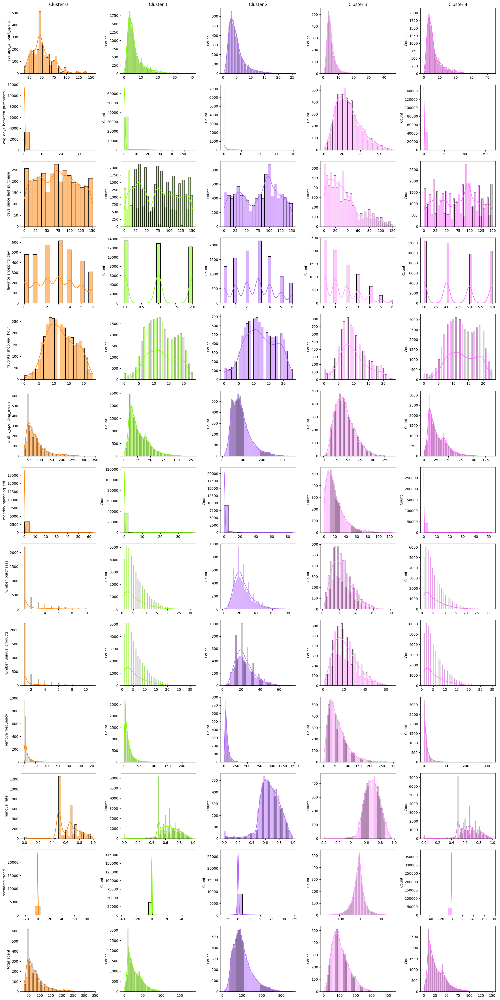

In [5]:
# Get unique cluster labels
clusters = customer_df['cluster'].unique()
num_clusters = len(clusters)
clusters.sort()

features = customer_df.columns.difference(['cluster','user_id','number_events'])

# Create a grid of subplots
fig, axes = plt.subplots(nrows=len(features), ncols=num_clusters, figsize=(20, 40), constrained_layout=True)

# Plot histograms for each feature in each cluster
for row, feature in enumerate(features):
    for col, cluster in enumerate(clusters):
        ax = axes[row, col]
        sns.histplot(customer_df[customer_df['cluster'] == cluster][feature], kde=True, ax=ax, color=palette[col])
        if col == 0:
            ax.set_ylabel(feature)
        if row == 0:
            ax.set_title(f'Cluster {cluster}')
        ax.set_xlabel('')

plt.tight_layout()
plt.show()

Les informations détaillées fournies par les histogrammes permettent une compréhension plus nuancée de chaque groupe, ce qui aide à affiner les profils pour représenter les comportements des clients avec plus de précision. Sur la base de l'analyse détaillée des diagrammes en radar et des histogrammes, voici les profils affinés et les titres de chaque groupe :

**Analyse globale**

- *Cluster 0: "Gros dépensiers occasionnels"*

Les clients du cluster 0 montrent une faible activité d'achat en termes de nombre d'achats et de diversité des produits, mais lorsqu'ils achètent, ils dépensent des sommes importantes. Leur engagement dans les activités de la plateforme est modéré. Ils font des achats relativement fréquemment, avec une préférence pour les jours en début de semaine et en dehors des heures de pointe. Leur comportement d'achat est très décidé, avec de faibles fréquences et taux de retrait des articles du panier. Malgré un faible nombre d'achats, leurs dépenses mensuelles sont relativement élevées et stables, avec une tendance à la hausse. Ce groupe pourrait bénéficier de stratégies visant à augmenter la fréquence de leurs achats tout en maintenant ou augmentant le montant moyen dépensé par achat.

- *Cluster 1: "Acheteurs modérés irréguliers"*

Les clients de ce cluster sont très engagés, participant à de nombreux événements et interagissant fréquemment. Cependant, cet engagement ne se traduit pas par des achats fréquents ou de grande valeur. Ils dépensent peu en général et montrent une préférence pour des produits spécifiques avec une faible diversité dans leurs achats. Bien qu'ils aient tendance à acheter à des moments spécifiques, ils hésitent peu avant de finaliser leurs achats. La tendance des dépenses est légèrement à la hausse, suggérant un potentiel d'augmentation des dépenses futures avec des stratégies de réengagement appropriées.

- *Cluster 2 : "Acheteurs fréquents et diversifiés"*

Les clients de ce cluster sont extrêmement engagés, participant à de nombreux événements et effectuant fréquemment des achats. Ils achètent une grande variété de produits et dépensent globalement plus que la moyenne, bien que le montant moyen par achat soit légèrement inférieur à la moyenne. Leur fréquence d'achat est élevée, et ils montrent une certaine hésitation avant de finaliser leurs achats, comme en témoignent les fréquences et les taux de retrait d'articles élevés. Leurs dépenses mensuelles sont élevées et relativement stables, avec une tendance marquée à la hausse, ce qui suggère un potentiel de croissance continue de leurs dépenses.

- *Cluster 3 : "Acheteurs Engagés mais Hésitants et Décroissants"*

Les clients de ce cluster montrent un engagement élevé en termes de participation à des événements, mais leur activité d'achat récente est très faible, avec des périodes longues entre les achats. Quand ils achètent, ils dépensent de manière significative et achètent une variété de produits, mais leurs habitudes d'achat sont très irrégulières. Leur tendance de dépenses est fortement négative, ce qui indique qu'ils réduisent progressivement leurs dépenses. Ils montrent une préférence pour des horaires atypiques pour faire leurs achats et ont une forte propension à retirer des articles de leurs paniers avant de finaliser les achats. Ces clients pourraient nécessiter des stratégies spécifiques pour réengager et stabiliser leurs comportements d'achat.

- *Cluster 4 : "Acheteurs modérés réguliers"*

Les clients du cluster 4 montrent un bon engagement avec une participation active à de nombreux événements, mais leur nombre d'achats et leurs dépenses totales sont faibles. Ils achètent une petite variété de produits et dépensent peu en moyenne par achat. Malgré cela, ils font des achats plus fréquemment, mais avec des montants faibles, et montrent une préférence pour les achats en fin de semaine et pendant les heures de pointe. Leur comportement d'achat est assez décidé avec une faible fréquence et un taux de retrait des articles. Les dépenses mensuelles sont faibles et stables, avec une légère tendance à la hausse. Ce groupe pourrait bénéficier de stratégies incitatives pour augmenter leur panier moyen et diversifier leurs achats.